In [1]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
import numpy as np

In [2]:
import matplotlib.pyplot as plt
from matplotlib import rc
import seaborn as sns
from pylab import rcParams

%matplotlib inline

sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 14, 8

In [3]:
import pandas as pd


In [4]:
df = pd.read_csv("/content/BTC-USD.csv")
df

,Date,Open,High,Low,Close,Adj Close,Volume
0,2014-09-17,465.864014,468.174011,452.421997,457.334015,457.334015,21056800
1,2014-09-18,456.859985,456.859985,413.104004,424.440002,424.440002,34483200
2,2014-09-19,424.102997,427.834991,384.532013,394.795990,394.795990,37919700
3,2014-09-20,394.673004,423.295990,389.882996,408.903992,408.903992,36863600
4,2014-09-21,408.084991,412.425995,393.181000,398.821014,398.821014,26580100
...,...,...,...,...,...,...,...
3105,2023-03-19,26969.503906,28440.560547,26907.716797,28038.675781,28038.675781,37769448859
3106,2023-03-20,28041.601563,28527.724609,27242.880859,27767.236328,27767.236328,44774027664
3107,2023-03-21,27768.392578,28439.562500,27439.646484,28175.816406,28175.816406,36102192830
3108,2023-03-22,28158.720703,28803.335938,26759.996094,27307.437500,27307.437500,33382021890


Text(0, 0.5, 'Close Price (USD)')

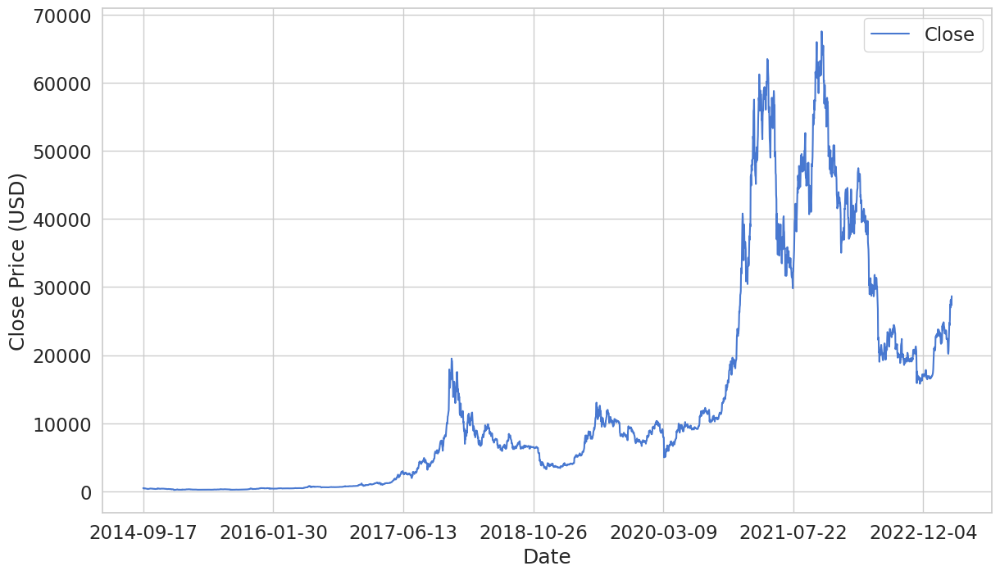

In [5]:
ax = df.plot(x='Date', y='Close')
ax.set_xlabel("Date")
ax.set_ylabel("Close Price (USD)")

In [6]:
# from sklearn.preprocessing import MinMaxScaler

# scaler = MinMaxScaler()

# close_price = df.Close.values.reshape(-1, 1)

# scaled_close = scaler.fit_transform(close_price)

# #scaled_close = scaled_close[~np.isnan(scaled_close)]

# scaled_close = scaled_close.reshape(-1, 1)

In [7]:
# SEQ_LEN = 100

# def to_sequences(data, seq_len):
#     d = []

#     for index in range(len(data) - seq_len):
#         d.append(data[index: index + seq_len])

#     return np.array(d)

# def preprocess(data_raw, seq_len, train_split):

#     data = to_sequences(data_raw, seq_len)

#     num_train = int(train_split * data.shape[0])

#     X_train = data[:num_train, :-1, :]
#     y_train = data[:num_train, -1, :]

#     X_test = data[num_train:, :-1, :]
#     y_test = data[num_train:, -1, :]

#     return X_train, y_train, X_test, y_test


# X_train, y_train, X_test, y_test = preprocess(scaled_close, SEQ_LEN, train_split = 0.95)

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [9]:
df.rename(columns = {'Adj Close':'Adj_Close'}, inplace= True)
del df['Date']

In [10]:
from sklearn.preprocessing import MinMaxScaler

In [11]:
# df = df.drop(columns=["Open", "High", "Low", "Adj Close", "Volume"])
# df = df.rename(columns={"Close": "price"})
# prices = df["price"].values.reshape(-1, 1)

In [12]:
def normalize_data(df):
  close_scaler = MinMaxScaler()

  close_price = df.Close.values.reshape(-1, 1)

  scaled_close = close_scaler.fit_transform(close_price)

  
  open_scaler = MinMaxScaler()

  open_price = df.Open.values.reshape(-1, 1)

  scaled_open = open_scaler.fit_transform(open_price)


  adj_close_scaler = MinMaxScaler()

  adj_close = df.Adj_Close.values.reshape(-1, 1)

  scaled_adj_close = adj_close_scaler.fit_transform(adj_close)

  
  High_scaler = MinMaxScaler()

  high = df.High.values.reshape(-1, 1)

  scaled_high = High_scaler.fit_transform(high)


  low_scaler = MinMaxScaler()

  low = df.Low.values.reshape(-1, 1)

  scaled_low = low_scaler.fit_transform(low)

  
  volume_scaler = MinMaxScaler()

  volume = df.Volume.values.reshape(-1, 1)

  scaled_volume = volume_scaler.fit_transform(volume)

  df['Open'] = scaled_open
  df['High'] = scaled_high
  df['Low'] = scaled_low
  df['Close'] = scaled_close
  df['Adj_Close'] = scaled_open
  df['Volume'] = scaled_volume

  return df, close_scaler

In [13]:
def split_sequences(seq, n_steps, device):
    X, y = [], []
    for i in range(len(seq) - n_steps):
        seq_x, seq_y = seq[i:(i + n_steps), :], seq[i + n_steps, :]
        X.append(seq_x)
        y.append(seq_y)
    x, y = np.array(X), np.array(y)
    return torch.from_numpy(x).float().to(device), torch.from_numpy(y).float().to(device)

In [14]:
class RNNModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_layers, output_dim):
        super(RNNModel, self).__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers

        
        self.rnn = nn.RNN(input_dim, hidden_dim, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).to(device)

        out, _ = self.rnn(x, h0)
        out = self.fc(out[:, -1, :])
        return out

In [15]:
train_prop = 0.8
test_prop = 0.1
val_prop = 0.1
n_timesteps = 30

In [16]:
# Split data into train and test sets

df_test = df[-300:]
df_test, test_close_scaler = normalize_data(df_test)
sq_test = df_test.to_numpy()

df_train = df[:-300]
df_val = df_test
df_train, _ = normalize_data(df_train)
df_val, _ = normalize_data(df_val)
sq_train = df_train.to_numpy()
sq_val = df_val.to_numpy()

X_test, y_test = split_sequences(sq_test, n_timesteps, device)
X_train, y_train = split_sequences(sq_train, n_timesteps, device)
X_valid, y_valid = split_sequences(sq_val, n_timesteps, device)

<ipython-input-12-7c77ae8bff0f>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Open'] = scaled_open
<ipython-input-12-7c77ae8bff0f>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['High'] = scaled_high
<ipython-input-12-7c77ae8bff0f>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

In [17]:
df_train

,Open,High,Low,Close,Adj_Close,Volume
0,0.004289,0.003739,0.004243,0.004144,0.004289,0.000043
1,0.004155,0.003574,0.003649,0.003655,0.004155,0.000081
2,0.003669,0.003151,0.003217,0.003216,0.003669,0.000091
3,0.003232,0.003085,0.003298,0.003425,0.003232,0.000088
4,0.003431,0.002927,0.003348,0.003275,0.003431,0.000059
...,...,...,...,...,...,...
2805,0.447250,0.442983,0.435037,0.429164,0.447250,0.089689
2806,0.429316,0.431081,0.432183,0.437425,0.429316,0.075822
2807,0.437509,0.436672,0.441220,0.436041,0.437509,0.078411
2808,0.436198,0.431953,0.424259,0.431662,0.436198,0.104765


In [18]:
class SMAPELoss(nn.Module):
    def __init__(self):
        super(SMAPELoss, self).__init__()

    def forward(self, pred, target):
        numerator = torch.abs(pred - target)
        denominator = torch.abs(pred) + torch.abs(target)
        smape = (numerator / denominator) / 2
        return torch.mean(smape)

In [19]:
# Scale data
# scaler = MinMaxScaler()
# prices = scaler.fit_transform(prices)



# Define training parameters
input_dim = 6
hidden_dim = 96
num_layers = 3
output_dim = 6
learning_rate = 0.001
num_epochs = 500
best_loss = -1

# Instantiate RNN model
model = RNNModel(input_dim, hidden_dim, num_layers, output_dim)
model.to(device)

# Define loss function and optimizer
criterion = SMAPELoss()
criterion_test = torch.nn.MSELoss(reduction='mean')
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
train_loss_plot = []
val_loss_plot = []

model.train()


# Train RNN model
for epoch in range(num_epochs):
    # Forward pass
    pred_train = model(X_train)
    pred_train = pred_train.squeeze(dim=1)
    #print(pred_train)
    # Compute loss
    train_loss = criterion(pred_train, y_train)

    # Backward pass and optimization
    optimizer.zero_grad()
    train_loss.backward()
    optimizer.step()

    # Print loss every 100 epochs
    if (epoch+1) % 100 == 0:
      print("Epoch [{}/{}], Loss: {:.4f}".format(epoch+1, num_epochs, train_loss.item()))
    train_loss_plot.append(train_loss)

    with torch.no_grad():
        # Forward pass
        pred_valid = model(X_valid)
        pred_valid = pred_valid.squeeze(dim=1)

        # Compute loss
        val_loss = criterion(pred_valid, y_valid)
        val_loss_plot.append(val_loss)
        if best_loss == -1 or best_loss > val_loss:
            best_loss = val_loss
            torch.save(model.state_dict(), '/content/rnn_state_dict_model.pt')
            patient = 0
            best_epoch = epoch
        else:
            patient += 1
    if patient >= 100:
      break

print(best_epoch)


Epoch [100/500], Loss: 0.2913
Epoch [200/500], Loss: 0.2243
101


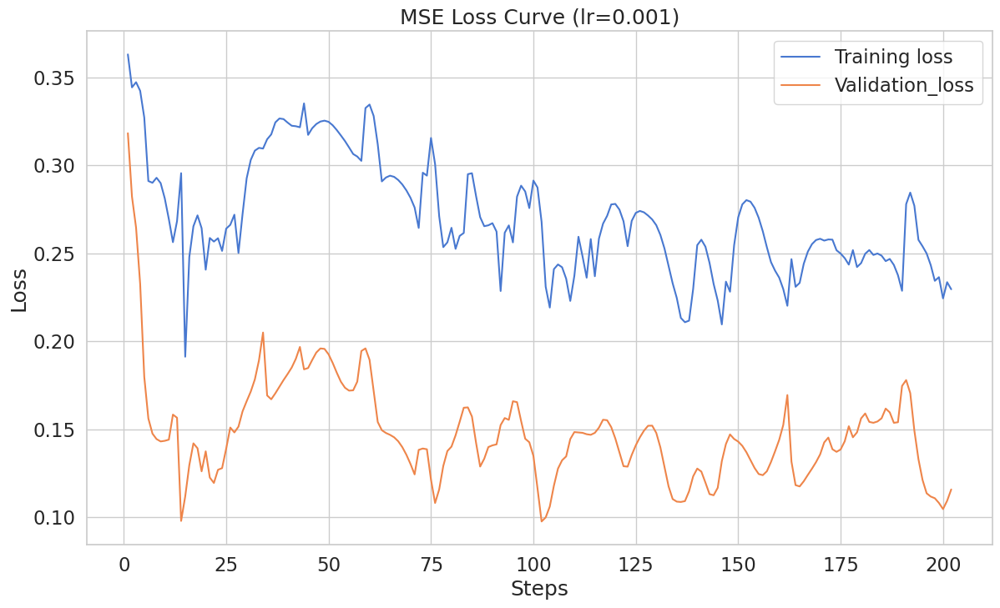

In [20]:
updates = [i for i in range(1, len(train_loss_plot) + 1)]
plt.plot(updates, torch.tensor(train_loss_plot).detach().numpy(), label="Training loss")
plt.plot(updates, torch.tensor(val_loss_plot).detach().numpy(), label="Validation_loss")
plt.title("MSE Loss Curve (lr=0.001)")
plt.xlabel("Steps")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [21]:
# Evaluate RNN model

model = RNNModel(input_dim, hidden_dim, num_layers, output_dim)
model.to(device)
model.load_state_dict(torch.load('/content/rnn_state_dict_model.pt'))
model.eval()

# pred = []
# label = []
# loss = []


# X_test

# # Make predictions on test set
# pred_test = model(X_test)

# # Compute test loss
# test_loss = criterion(pred_test, y_test)
# print("Test Loss: {:.4f}".format(test_loss.item()))



RNNModel(
  (rnn): RNN(6, 96, num_layers=3, batch_first=True)
  (fc): Linear(in_features=96, out_features=6, bias=True)
)

In [22]:
# preds = []
# labels = []
# losses = []
# running_loss = 0

# X_test_copy = X_test.clone()
# test_data = X_test_copy[0:1]

# for i in range(len(X_test)):

#   if i + 30 > len(X_test):
#     break
#   # auto-regressively predict the next 30 days from i
#   test_pred = model(test_data)
  
#   # update X_test with the latest prediction
#   test_data_copy = test_data.clone()
#   test_data_copy[0, :-1, :] = test_data[0, 1:, :]
#   test_data[0, -1, :] = test_pred
#   test_data = test_data
#   test_label = y_test[i, 3].detach().cpu()

#   preds.append(test_pred[0, 3].detach().cpu())
#   labels.append(test_label)

In [23]:


X_test = X_test.cpu().numpy()
y_test = y_test.cpu().numpy()

In [24]:

preds = []
labels = []
test_losses = []
total_loss = 0

for i in range(len(X_test)):
  # start extrapolating from X_test[i]
  X_test_copy = X_test.copy()
  # y_test = y_test.copy()

  pred = []
  label = []
  if i + 30 > len(X_test):
    break
  # auto-regressively predict the next 30 days from i
  for j in range(i, i + 30):
    #print(i, j)
    X_trapolate = X_test_copy[j:j+1,:,:]
    with torch.no_grad():
      inpt = X_trapolate
      for k in range(len(pred)):
        X_trapolate[0][-k] = pred[k]
      # target = test_seq  
      x_batch = (
          torch.from_numpy(inpt).float().to(device)
      )  
      # mv_net.init_hidden(x_batch.size(0))
      # output = mv_net(x_batch)
      output = model(x_batch)
      t = output.cpu().view(-1).numpy()
      #print(t)
      # Produce output of the extrapolation
      pred.append([t[3]])
      label.append([y_test[j][3]])

  # test_loss = criterion(np.array(pred), np.array(label))
  # total_loss += test_loss
  # test_losses.append(test_loss)
  denormalized_pred = test_close_scaler.inverse_transform(np.array(pred))
  denormalized_label = test_close_scaler.inverse_transform(np.array(label))
  test_losses.append(np.square(denormalized_pred - denormalized_label).mean())  

  preds.append(denormalized_pred)
  labels.append(denormalized_label) 


test_loss = np.mean(test_losses)
#average_test_loss = total_loss/len(X_test)
        

In [25]:
print(test_loss)

5027630.5


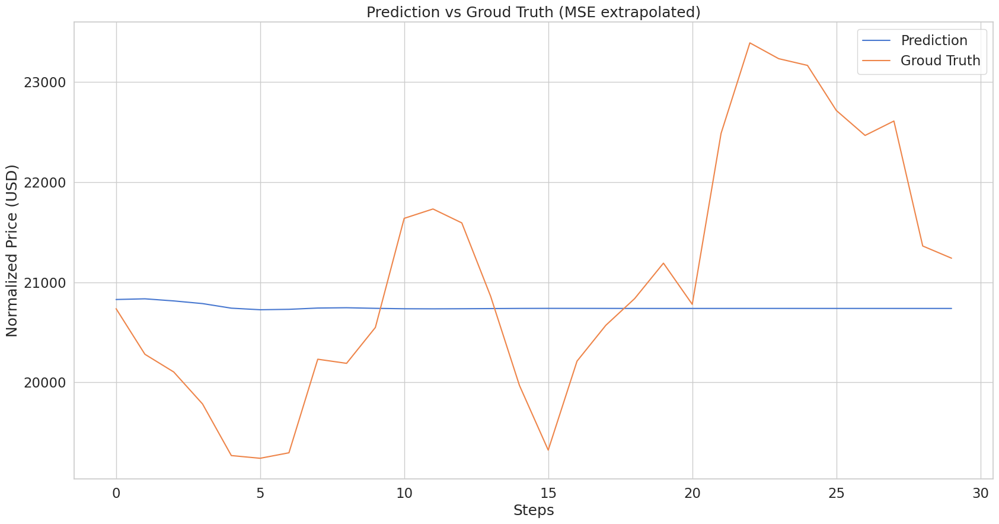

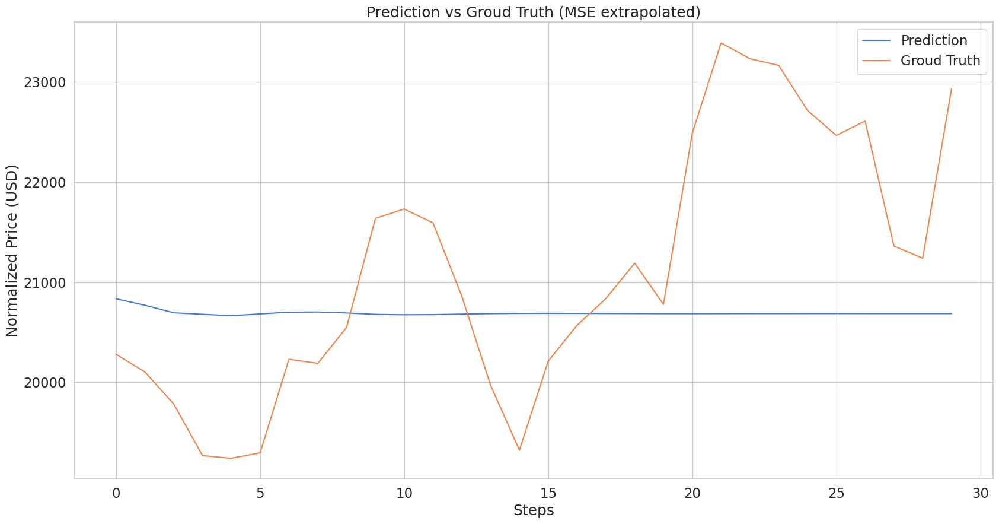

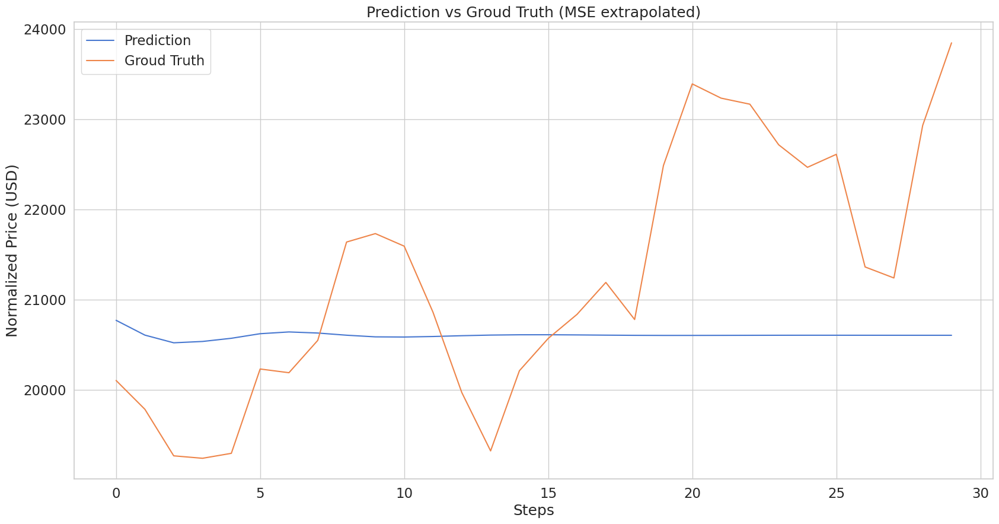

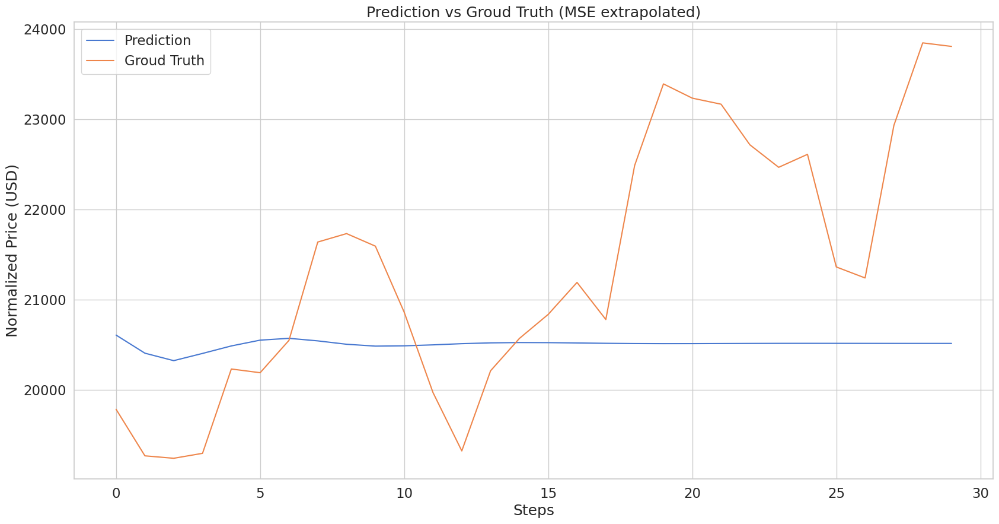

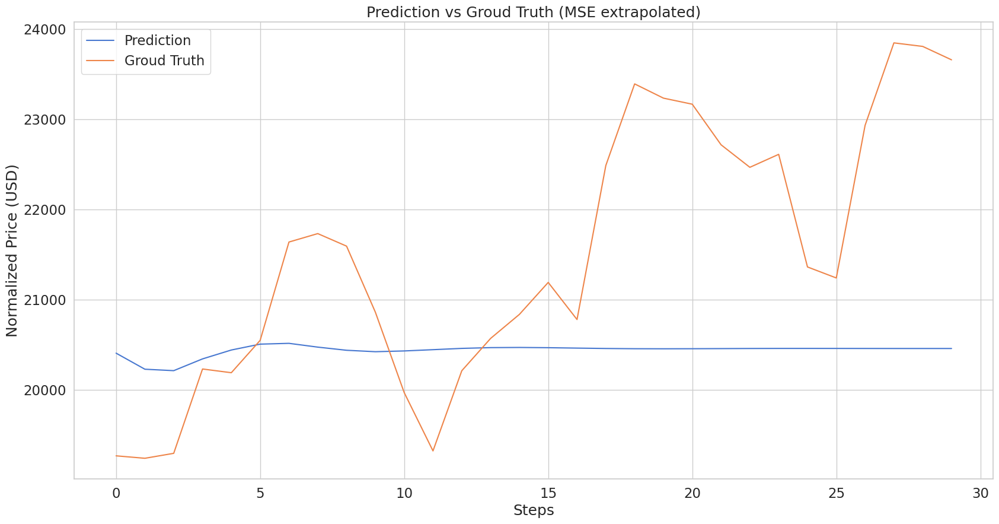

...

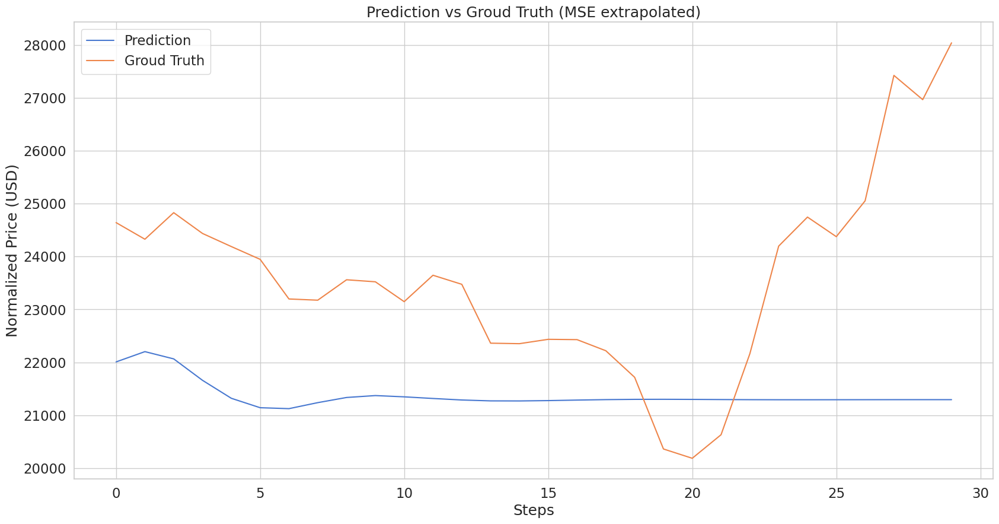

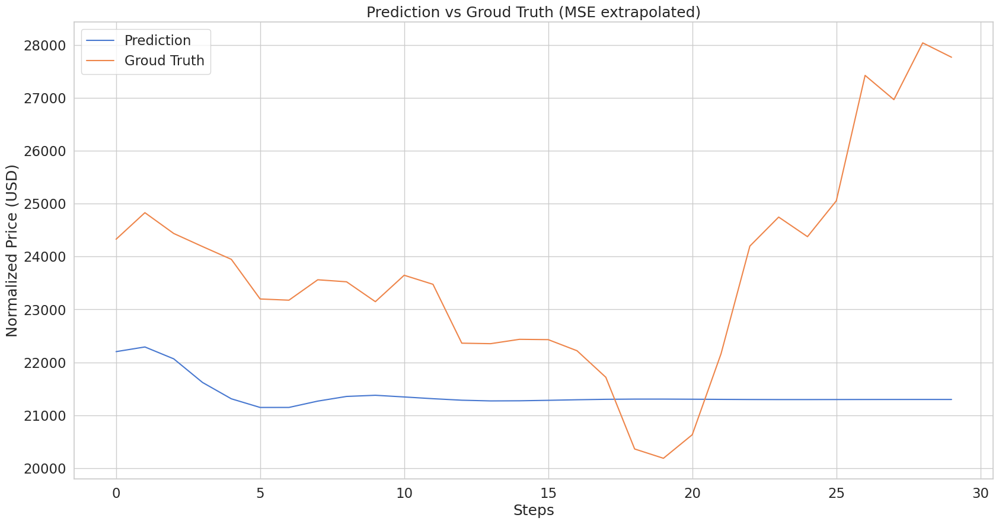

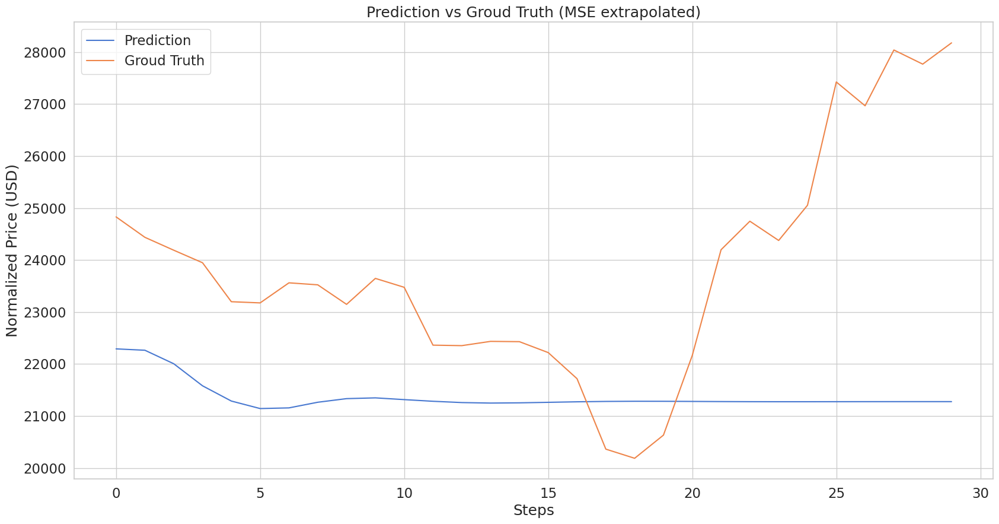

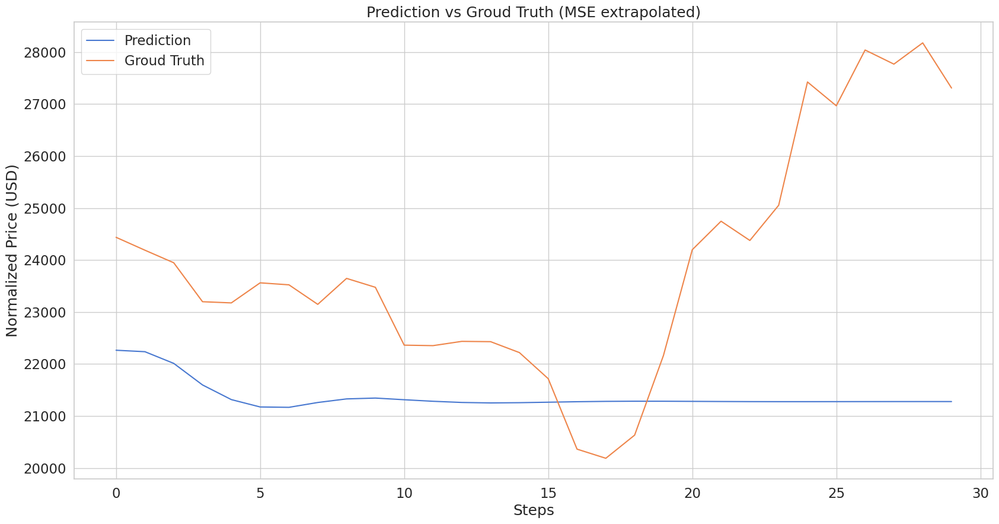

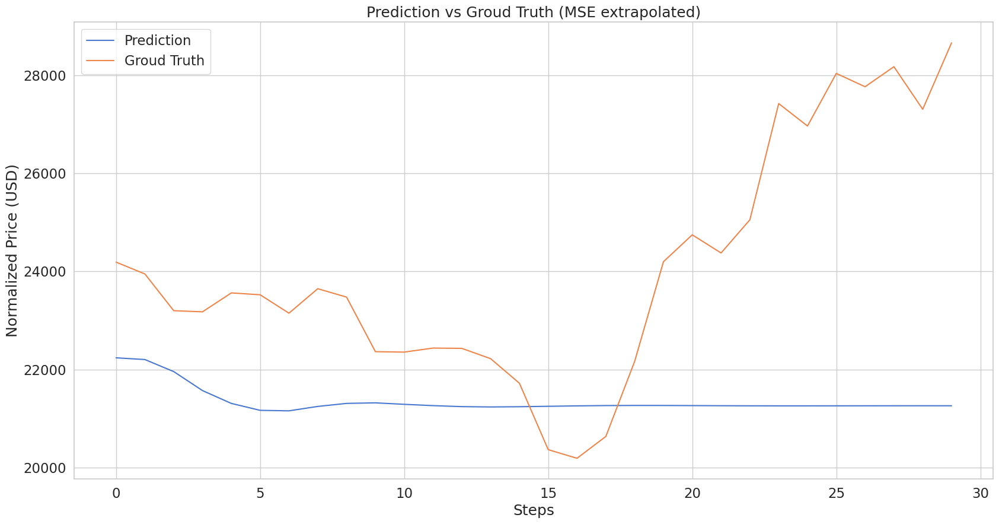

In [26]:
# Visualize preds vs labels
for j in range(len(preds)):
  pred = preds[j]
  label = labels[j]
  updates = [i for i in range(len(pred))]
  plt.figure(figsize=(20, 10))
  plt.plot(updates, pred, label="Prediction")
  plt.plot(updates, label, label="Groud Truth")
  plt.title("Prediction vs Groud Truth (MSE extrapolated)")
  plt.xlabel("Steps")
  plt.ylabel("Normalized Price (USD)")
  plt.legend()
  plt.show()
  #plt.savefig('')